In [1]:
from tensorflow.keras.layers import Input,Dense,Lambda
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras import metrics
from tensorflow.keras.datasets import mnist
from tensorflow.keras.callbacks import Callback
import imageio
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [2]:
batch_size = 100
original_dim =784
latent_dim = 2
intermediate_dim = 256
epochs = 50
epsilon_std = 1.

In [3]:
def sampling(args:tuple):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0],latent_dim),mean=0.,stddev=epsilon_std)
    return z_mean + K.exp(z_log_var / 2) * epsilon

In [4]:
x=Input(shape=(original_dim,),name='input')
h=Dense(intermediate_dim,activation='relu',name='encoding')(x)
z_mean = Dense(latent_dim,name='mean')(h)
z_log_var = Dense(latent_dim, name='log-varience')(h)
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var])
encoder =Model(x, [z_mean,z_log_var,z], name="encoder")

In [5]:
encoder.summary()

Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 784)]        0                                            
__________________________________________________________________________________________________
encoding (Dense)                (None, 256)          200960      input[0][0]                      
__________________________________________________________________________________________________
mean (Dense)                    (None, 2)            514         encoding[0][0]                   
__________________________________________________________________________________________________
log-varience (Dense)            (None, 2)            514         encoding[0][0]                   
____________________________________________________________________________________________

In [6]:
input_decoder = Input(shape = (latent_dim,),name='decoder_input')
decoder_h = Dense(intermediate_dim,activation='relu',name='decoder_h')(input_decoder)
x_decoded = Dense(original_dim, activation='sigmoid',name = "flat_decoded")(decoder_h)
decoder = Model(input_decoder,x_decoded, name = 'decoder')

In [7]:
decoder.summary()

Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
decoder_input (InputLayer)   [(None, 2)]               0         
_________________________________________________________________
decoder_h (Dense)            (None, 256)               768       
_________________________________________________________________
flat_decoded (Dense)         (None, 784)               201488    
Total params: 202,256
Trainable params: 202,256
Non-trainable params: 0
_________________________________________________________________


In [8]:
output_combined = decoder(encoder(x)[2])
vae = Model(x,output_combined)
vae.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 784)]             0         
_________________________________________________________________
encoder (Functional)         [(None, 2), (None, 2), (N 201988    
_________________________________________________________________
decoder (Functional)         (None, 784)               202256    
Total params: 404,244
Trainable params: 404,244
Non-trainable params: 0
_________________________________________________________________


In [9]:
kl_loss = -0.5 * K.sum(1+z_log_var - K.exp(z_log_var)-K.square(z_mean),axis=-1)
vae.add_loss(K.mean(kl_loss)/784.)
vae.compile(optimizer='rmsprop', loss='binary_crossentropy')

In [10]:
(x_train,y_train),(x_test,y_test) = mnist.load_data()

x_train = x_train.astype('float32')/255.
x_test = x_test.astype('float32')/255.

#np.prod = 배열의 
x_train = x_train.reshape((len(x_train), np.prod(x_train.shape[1:])))
x_test = x_test.reshape((len(y_test), np.prod(x_test.shape[1:])))

In [11]:
class LatentSpaceVisualization(Callback):
    def __init__(self, x_data,y_data,cmap= 'viridis',color_bar_activation = False):
        self.x_data = x_data
        self.y_data = y_data
        self.color_bar_activation = color_bar_activation
        
    
#     def on_epoch_begin(self,epoch,logs):
#         pass
    
#     def on_epoch_end(self,epoch,logs):
#         plt.figure(figsize=(20, 20))
#         plt.title(f"epoch : {epoch:02d}")
#         part_model = self.model.get_layer(name='encoder')
#         y_pred=part_model(self.x_data)[0]
#         plt.scatter(y_pred[:,0], y_pred[:,1], c=self.y_data, cmap='viridis')
#         plt.xlim(-6,6)
#         plt.ylim(-6,6)
#         if self.color_bar_activation: plt.colorbar()
#         plt.savefig(f'./vae_img/img_{epoch:04d}.jpg')

    def on_train_batch_begin(self,batch,lgs=None):
        plt.figure(figsize=(10, 10))
        plt.title(f"batch : {batch:02d}")
        part_model = self.model.get_layer(name='encoder')
        y_pred=part_model(self.x_data)[0]
        plt.scatter(y_pred[:,0], y_pred[:,1], c=self.y_data, cmap='viridis')
        plt.xlim(-10,10)
        plt.ylim(-10,10)
        if self.color_bar_activation: plt.colorbar()
        plt.savefig(f'./vae_img/img_{batch:04d}.jpg')


In [12]:
visualization=LatentSpaceVisualization(x_test, y_test)

 20/600 [>.............................] - ETA: 2:38 - loss: 0.4441

/opt/tljh/user/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


600/600 [==============================] - 181s 302ms/step - loss: 0.2443


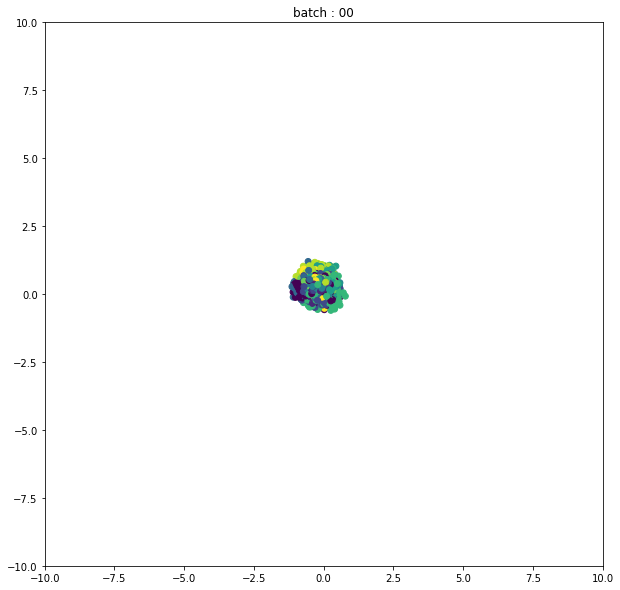

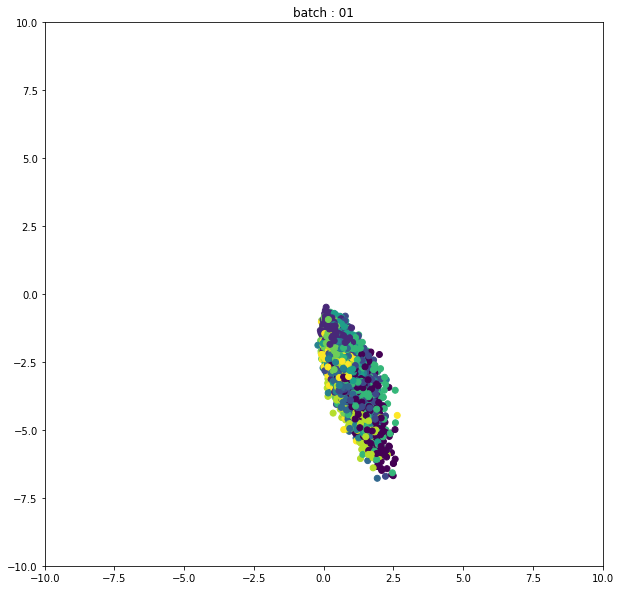

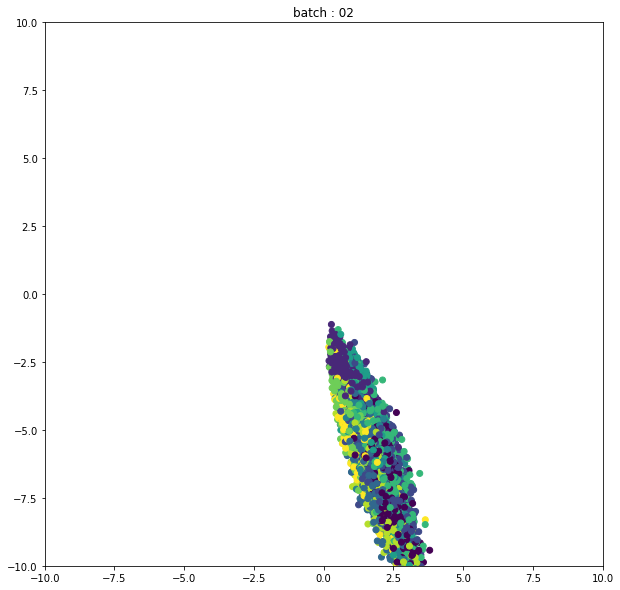

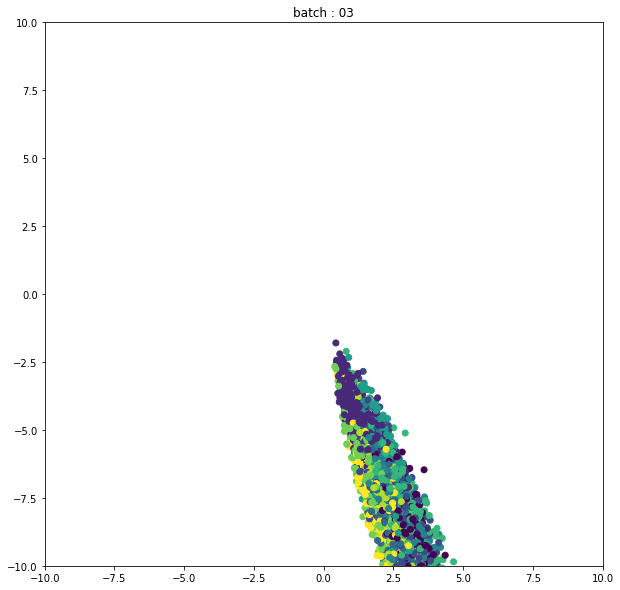

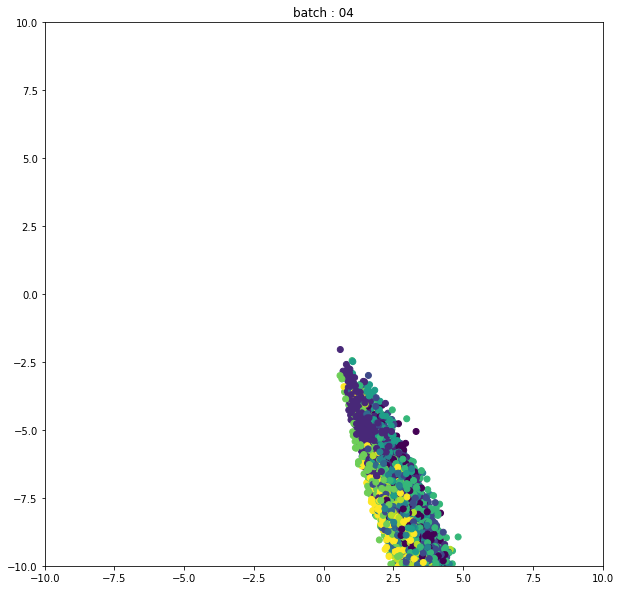

...

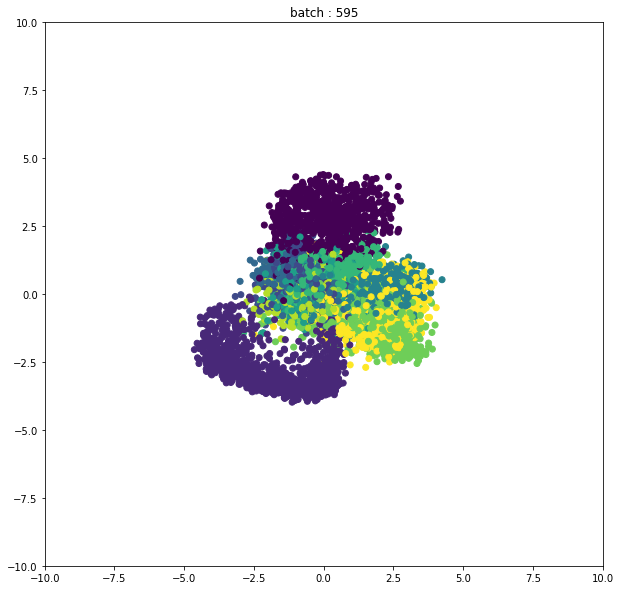

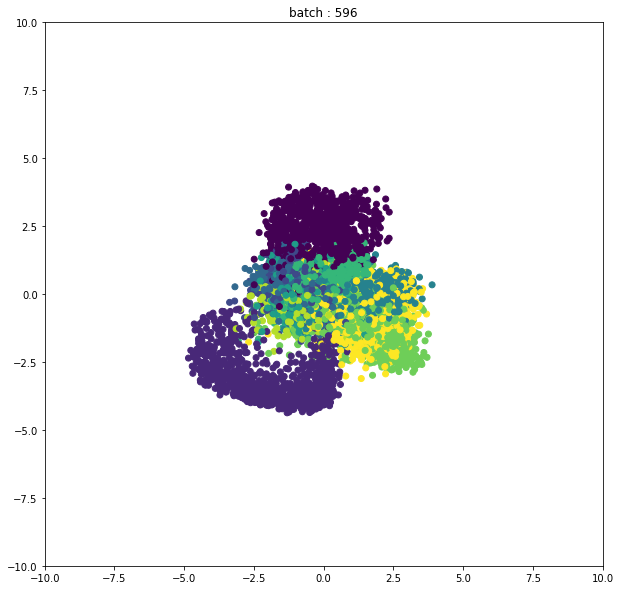

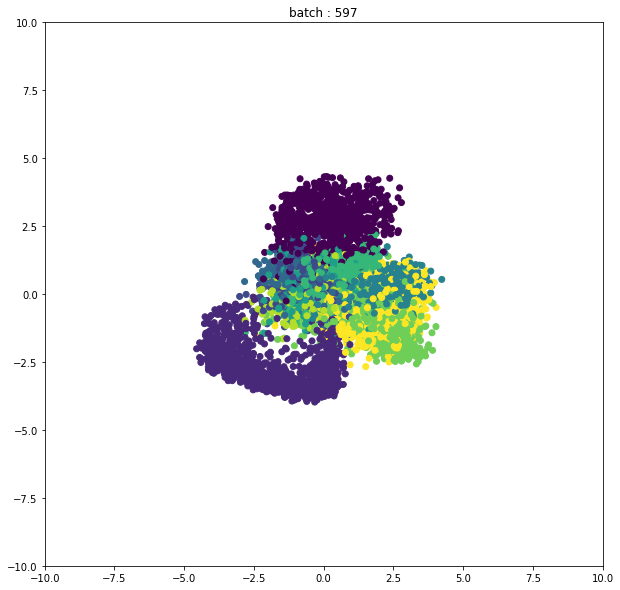

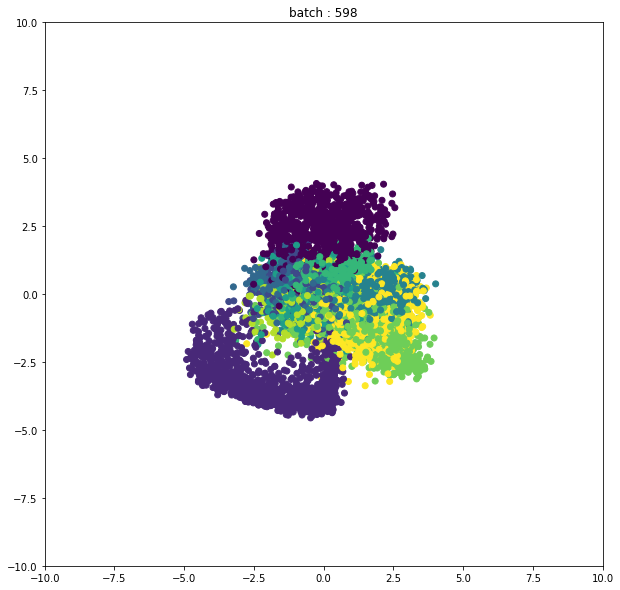

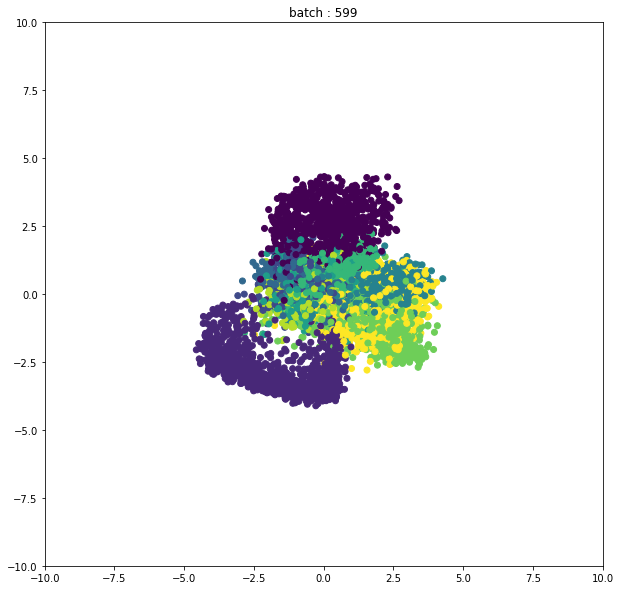

In [13]:
vae.fit(x_train,x_train,shuffle=True,epochs=1,batch_size=batch_size,callbacks=[visualization])

In [14]:
images = []

In [15]:
for i in range(0,600,3):
    img = cv2.imread(f'vae_img/img_{i:04d}.jpg')
    images.append(img)

In [16]:
imageio.mimsave('./result.gif',images,fps=15)